In [2]:
#!pip install spectrum_utils[iplot]

In [205]:
import spectrum_utils.spectrum as sus
import spectrum_utils.plot as sup
import pyteomics.mgf as mgf
import matplotlib.pyplot as plt
import numpy as np
import os
import matplotlib.backends.backend_pdf
import pandas as pd
import pickle
from pyteomics import mass, parser

In [2]:
#overwrite black picks to grey
sup.colors['?']="#c4c0c0"
sup.colors['f']="#c4c0c0"
sup.colors[None]="#c4c0c0"

In [76]:
sup.colors

{'a': '#388E3C',
 'b': '#1976D2',
 'c': '#00796B',
 'x': '#7B1FA2',
 'y': '#D32F2F',
 'z': '#F57C00',
 'm': '#FBC02D',
 'I': '#455A64',
 'p': '#512DA8',
 '?': '#c4c0c0',
 'f': '#c4c0c0',
 None: '#c4c0c0'}

In [2]:
# mzspec:PXD014258:ESC-HF-Sample-BT474_3.RAW.raw:scan:10356:KLLESEESHLESGMQNMSIHTK/4
# mzspec:PXD003594:b1369p080_sample_10_b.raw:scan:17234:YADL[UNIMOD:35]T[UNIMOD:35]E[UNIMOD:35]D[UNIMOD:35]L[UNIMOD:35]LPSC[UNIMOD:4]ESLKDTIAR/3
# mzspec:PXD003594:b1369p080_sample_01_a.raw:scan:15739:NQGT[UNIMOD:121]VNWSVDDIVK/2

In [3]:
# Define the MGF file path
mgf_folder = r'\\wsl.localhost\Ubuntu\home\vvshazia\tpp_pride_reanalysis\\'
#mgf_file = r'PXD002057\130327_o2_01_hu_C1_2hr.mgf'
#spectra = mgf.read(os.path.join(mgf_folder,mgf_file))
##mzspec:PXD002057:130327_o2_01_hu_C1_2hr.raw:scan:22921:IGIVDQSQQAYQEAFEISKK/2

In [4]:
nc_toexplore=pd.read_excel("nc_toexplose_novar_msm_bests.xlsx")

In [5]:
nc_toexplore.loc[nc_toexplore.dataset=="PXD003594","spectrum_file_x"]=nc_toexplore.loc[nc_toexplore.dataset=="PXD003594","spectrum_file_x"].str.replace('.raw', '.mgf')
nc_toexplore.loc[nc_toexplore.dataset=="PXD014258","spectrum_file_x"]=nc_toexplore.loc[nc_toexplore.dataset=="PXD014258","spectrum_file_x"].str.replace('.RAW.raw','.mgf')
nc_toexplore.loc[nc_toexplore.dataset=="PXD002057","spectrum_file_x"]=nc_toexplore.loc[nc_toexplore.dataset=="PXD002057","spectrum_file_x"].str.replace('.raw','.mgf')

In [6]:
#nc_toexplore["unimod_peptide"]=nc_toexplore.USI.str.split(":")[5]
#nc_toexplore = nc_toexplore.assign(unimod_peptide = lambda x: (x['USI'].str.split(":")[5]))
nc_toexplore["unimod_peptide"]=nc_toexplore.USI.apply(lambda x: ":".join(x.split(":")[5:]).split("/")[0])

In [7]:
nc_toexplore["unimod_peptide"].iloc[0]

'[UNIMOD:1]-AAK[UNIMOD:381]ALDRHQAHLC[UNIMOD:4]VLASNC[UNIMOD:4]DEPMYVK'

In [8]:
#find weird UNIMOD
#substitute:
unimod_fix={"9999989]":"1680]",
           "999928]":"536]",
           "9999111]":"1427]",
           "9999248]":"1450]",
           "9999986]":"1614]",
           "999990]":"60]",
           "9999936]":"1765]",
           "9999317]":"1763]",
           "9999575]":"285]",
           "9999833]":"1378]",
           "9999365]":"1599]",
           "9999805]":"1691]",
           "9999571]":"65]",
           "9999471]":"41]",
           "9999800]":"1377]",
           "9999558]":"1413]",
           "9999481]":"1434]",
           "9999212]":"1935]",
           "9999211]":"1441]",
           "99991]":"365]",
           "9999529]":"1368]",
           "9999122]":"149]",
           "9999999]":"1654]",
           "9999761]":"1596]",
           "9999363]":"1599]",
           "9999297]":"1932]",
           "9999292]":"1936]",
           "9999210]":"1441]",
           "9999126]":"1786]",
           "9999124]":"149]"}
for i,row in nc_toexplore.iterrows():
    s=row["unimod_peptide"]
    for k,v in unimod_fix.items():
        s=s.replace(k,v)
    nc_toexplore.loc[i,"unimod_peptide"]=s

In [46]:
nc_toexplore.loc[nc_toexplore.dataset=="PXD014258","spectrum_file_x"]=nc_toexplore.loc[nc_toexplore.dataset=="PXD014258","spectrum_file_x"].apply(lambda x: x.replace(".mgf",".RAW.mgf"))

scan=12293 130327_o2_01_hu_C1_2hr [UNIMOD:1]-AAK[UNIMOD:381]ALDRHQAHLC[UNIMOD:4]VLASNC[UNIMOD:4]DEPMYVK 4 PXD002057 0
130327_o2_01_hu_C1_2hr.12293.12293.4 File:"130327_o2_01_hu_C1_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=12293"
scan=34011 130327_o2_01_hu_C1_2hr AC[UNIMOD:4]AIGILM[UNIMOD:35]KDLAGELALVDVMEDK 3 PXD002057 1
130327_o2_01_hu_C1_2hr.34011.34011.3 File:"130327_o2_01_hu_C1_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=34011"
scan=21058 130327_o2_06_hu_P3_2hr ADASSTS[UNIMOD:977]SFLDSDELER 2 PXD002057 2
130327_o2_06_hu_P3_2hr.21058.21058.2 File:"130327_o2_06_hu_P3_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=21058"
scan=20421 130327_o2_04_hu_P2_2hr AEISEMNRNISWLQAEIEGLKGQR 4 PXD002057 3
130327_o2_04_hu_P2_2hr.20421.20421.4 File:"130327_o2_04_hu_P2_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=20421"
scan=22519 130327_o2_04_hu_P2_2hr AENGKLVINENPIT[UNIMOD:1680]IFQERDPSK 3 PXD002057 4
130327_o2_04_hu_P2_2hr.22519.225

C:\Users\vasv1101\AppData\Local\Temp\ipykernel_151244\1975416505.py:69: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=(12, 6))


scan=19213 130327_o2_05_hu_C3_2hr IEGEIIVC[UNIMOD:4]AAYAHELPK 3 PXD002057 21
130327_o2_05_hu_C3_2hr.19213.19213.3 File:"130327_o2_05_hu_C3_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=19213"
scan=25521 130327_o2_06_hu_P3_2hr IEM[UNIMOD:35]ELRDISNDVLSLLEK 2 PXD002057 22
130327_o2_06_hu_P3_2hr.25521.25521.2 File:"130327_o2_06_hu_P3_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=25521"
scan=22921 130327_o2_01_hu_C1_2hr IGIVDQSQQAYQEAFEISKK 2 PXD002057 23
130327_o2_01_hu_C1_2hr.22921.22921.2 File:"130327_o2_01_hu_C1_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=22921"
scan=7412 130327_o2_01_hu_C1_2hr [UNIMOD:39]-IGVHHYSGNNIELGTAC[UNIMOD:4]GK 2 PXD002057 24
130327_o2_01_hu_C1_2hr.7412.7412.2 File:"130327_o2_01_hu_C1_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=7412"
scan=11052 130327_o2_06_hu_P3_2hr ILK[UNIMOD:903]EGGYSFTTTAER 3 PXD002057 25
130327_o2_06_hu_P3_2hr.11052.11052.3 File:"130327_o2_06_hu_P3_2hr.raw", NativeID:"controll

scan=15933 130327_o2_04_hu_P2_2hr SGDAAIVDM[UNIMOD:35]VPGKPVYVESFSDYPPLGR 3 PXD002057 58
130327_o2_04_hu_P2_2hr.15933.15933.3 File:"130327_o2_04_hu_P2_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=15933"
scan=27729 130327_o2_06_hu_P3_2hr SLDM[UNIMOD:35]DNTIAEVK 3 PXD002057 59
130327_o2_06_hu_P3_2hr.27729.27729.3 File:"130327_o2_06_hu_P3_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=27729"
scan=25205 130327_o2_05_hu_C3_2hr SVFIKNSSY[UNIMOD:1255]VILKADQLTEEQIAEFK 4 PXD002057 60
130327_o2_05_hu_C3_2hr.25205.25205.4 File:"130327_o2_05_hu_C3_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=25205"
scan=19273 130327_o2_05_hu_C3_2hr SYELPDDQVITIDNER 2 PXD002057 61
130327_o2_05_hu_C3_2hr.19273.19273.2 File:"130327_o2_05_hu_C3_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=19273"
scan=22143 130327_o2_06_hu_P3_2hr T[UNIMOD:122]IVAIENPADVSVISSR 2 PXD002057 62
130327_o2_06_hu_P3_2hr.22143.22143.2 File:"130327_o2_06_hu_P3_2hr.raw", NativeID:"co

controllerType=0 controllerNumber=1 scan=17234
scan=8077 b1369p080_sample_01_a YEELQAL[UNIMOD:35]AGK 2 PXD003594 110
controllerType=0 controllerNumber=1 scan=8077
scan=3789 b1369p080_sample_07_b YLAEVAAGDGKK[UNIMOD:6] 2 PXD003594 111
controllerType=0 controllerNumber=1 scan=3789
scan=16188 b1369p080_sample_06_a YPIKHG[UNIMOD:420]IVTNWDDMEK 3 PXD003594 112
controllerType=0 controllerNumber=1 scan=16188
scan=22232 ESC-HF-Sample-MCF4 [UNIMOD:1]-AEEGIAAGGI[UNIMOD:425]R[UNIMOD:425]D[UNIMOD:421]V[UNIMOD:425]TTALQEVLK 2 PXD014258 113
controllerType=0 controllerNumber=1 scan=22232
scan=20030 ESC-HF-Sample-BT474_5 AIATGGAVFGEEGLT[UNIMOD:1843]LNLEDVQPHDLGK 4 PXD014258 114
controllerType=0 controllerNumber=1 scan=20030
scan=23498 ESC-HF-Sample-BT474_5 ALM[UNIMOD:35]LQGIDLLADAVALTM[UNIMOD:35]GPK 3 PXD014258 115
controllerType=0 controllerNumber=1 scan=23498
scan=18576 ESC-HF-Sample-BT474_2 C[UNIMOD:4]RAS[UNIMOD:1441]LLLQT[UNIMOD:1441]T[UNIMOD:1441]VHAIT[UNIMOD:1441]AT[UNIMOD:1441]QKTVDGPSGK 4 PXD0

scan=13350 ESC-HF-Sample-MCF4 LVEALC[UNIMOD:4][UNIMOD:4]AE[UNIMOD:1827]HQIDLIKVDDNKK 4 PXD014258 170
controllerType=0 controllerNumber=1 scan=13350
scan=13521 ESC-HF-Sample-BT474_5 LVQDVANNTNEETGDGPTTATVLAR 3 PXD014258 171
controllerType=0 controllerNumber=1 scan=13521
scan=8703 ESC-HF-Sample-MCF4 [UNIMOD:1]-M[UNIMOD:35]AAC[UNIMOD:4][UNIMOD:4][UNIMOD:4]M[UNIMOD:35]KSVTKQGAELSNEER 2 PXD014258 172
controllerType=0 controllerNumber=1 scan=8703
scan=15045 ESC-HF-Sample-MCF5 [UNIMOD:1]-M[UNIMOD:35]AC[UNIMOD:4][UNIMOD:4]ARLLISVYSESGESSGKNVTLPAVFK 2 PXD014258 173
controllerType=0 controllerNumber=1 scan=15045
scan=20790 ESC-HF-Sample-MCF5 M[UNIMOD:35]AVT[UNIMOD:926]FIGS[UNIMOD:926]S[UNIMOD:926]T[UNIMOD:926]AIQELFK 3 PXD014258 174
controllerType=0 controllerNumber=1 scan=20790
scan=9602 ESC-HF-Sample-MCF5 MDSTEPPYSQK[UNIMOD:1368]REEEIVK 3 PXD014258 175
controllerType=0 controllerNumber=1 scan=9602
scan=8789 ESC-HF-Sample-BT474_2 M[UNIMOD:35][UNIMOD:35]NHEKYDNSLKIVSNASC[UNIMOD:4][UNIMOD:4]TTNC[

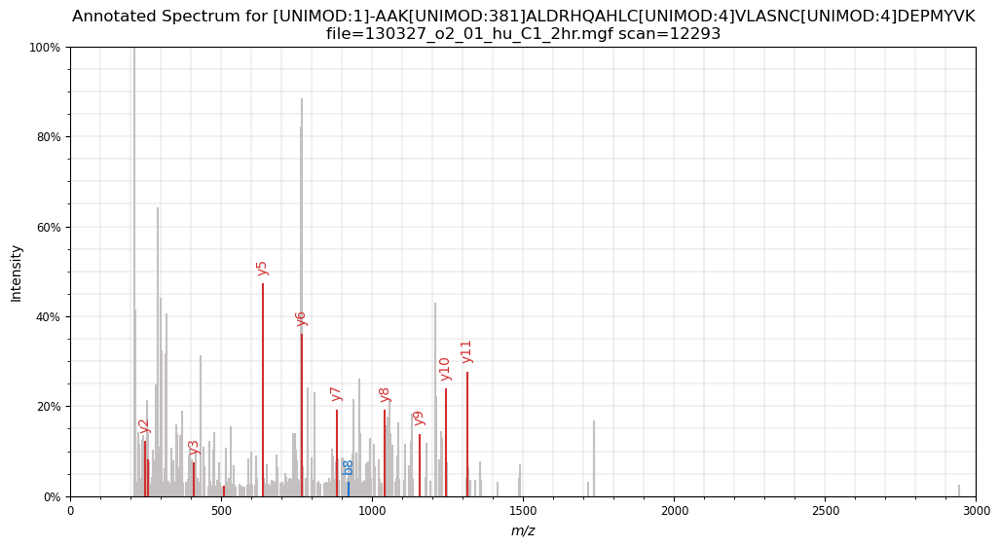

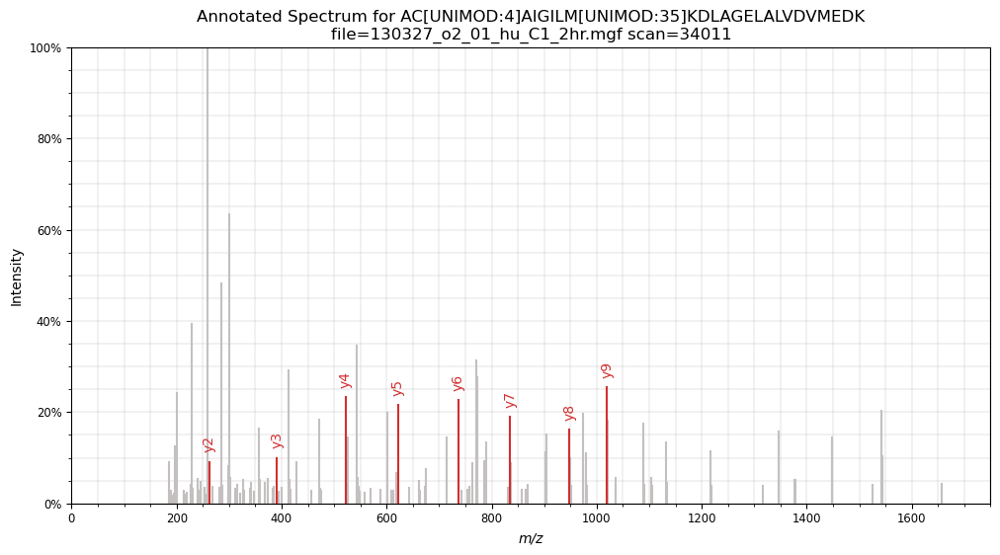

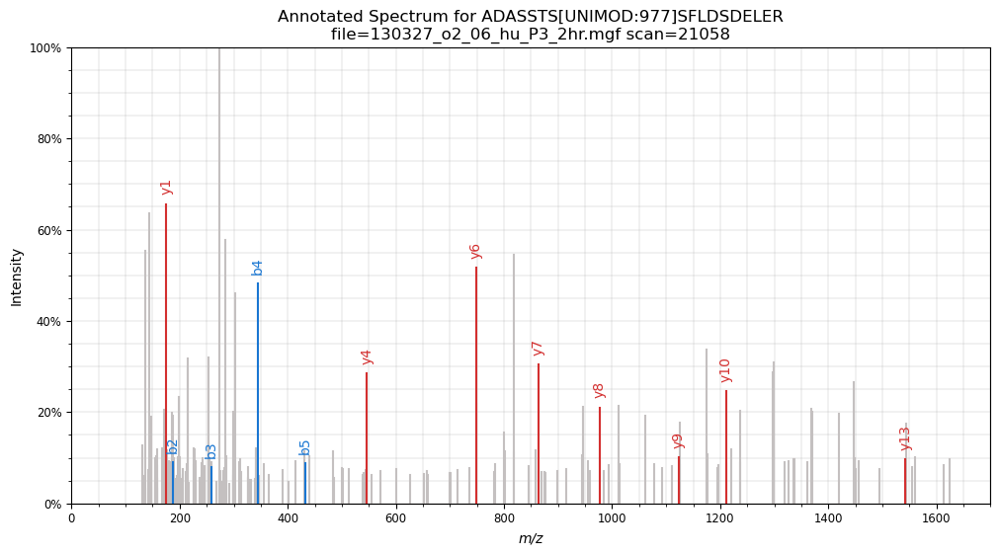

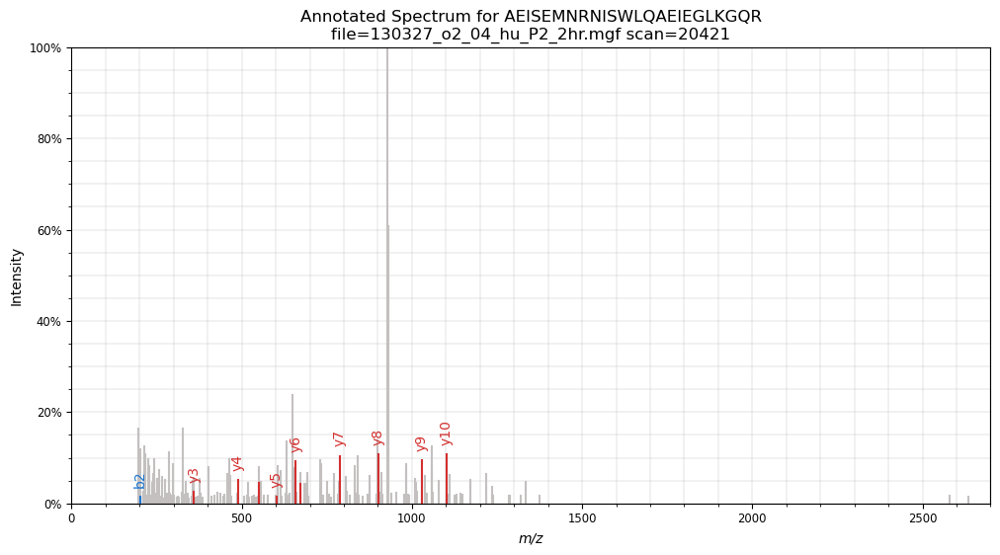

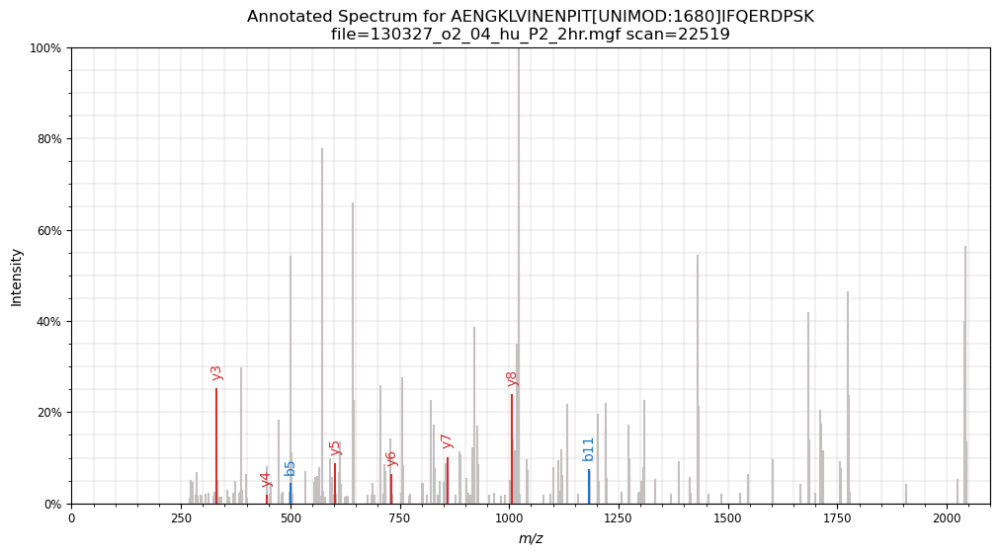

...

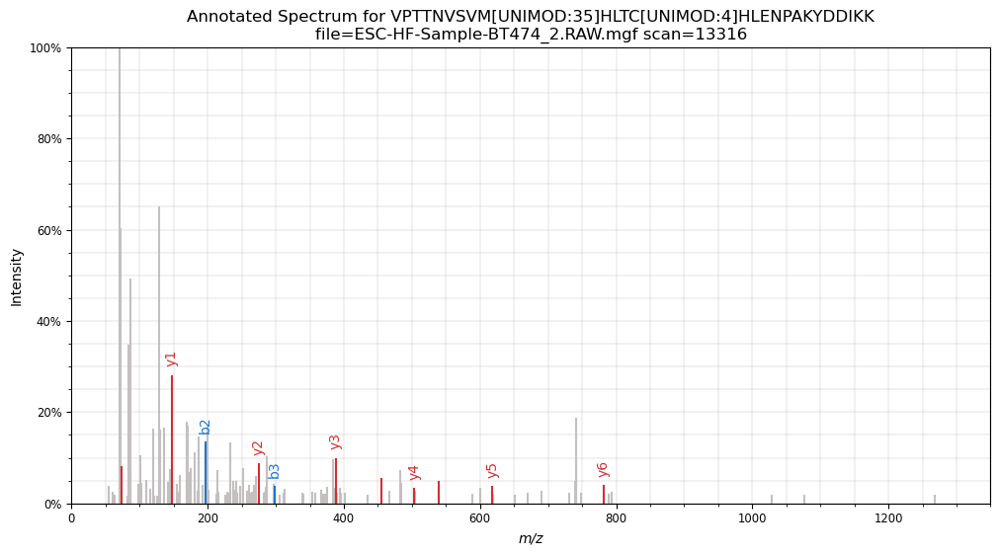

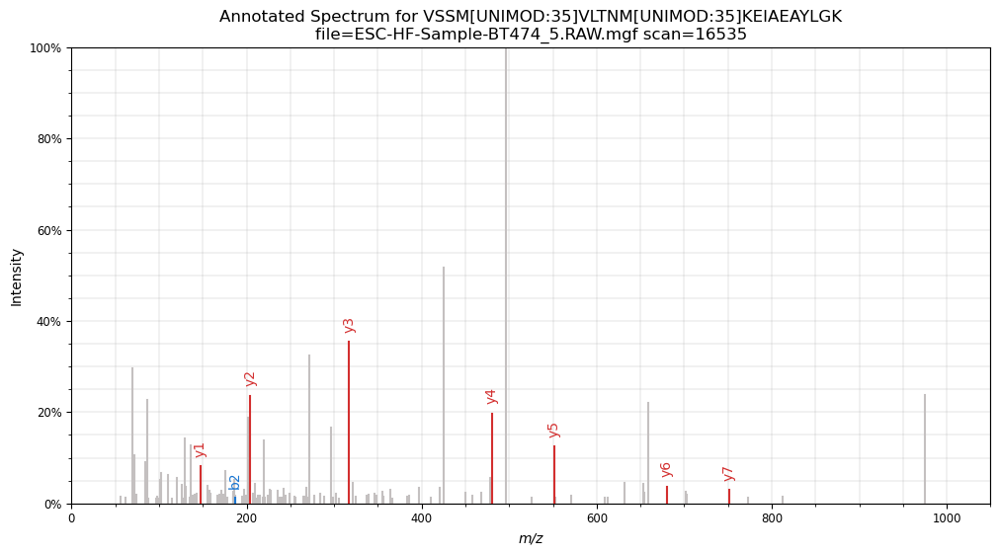

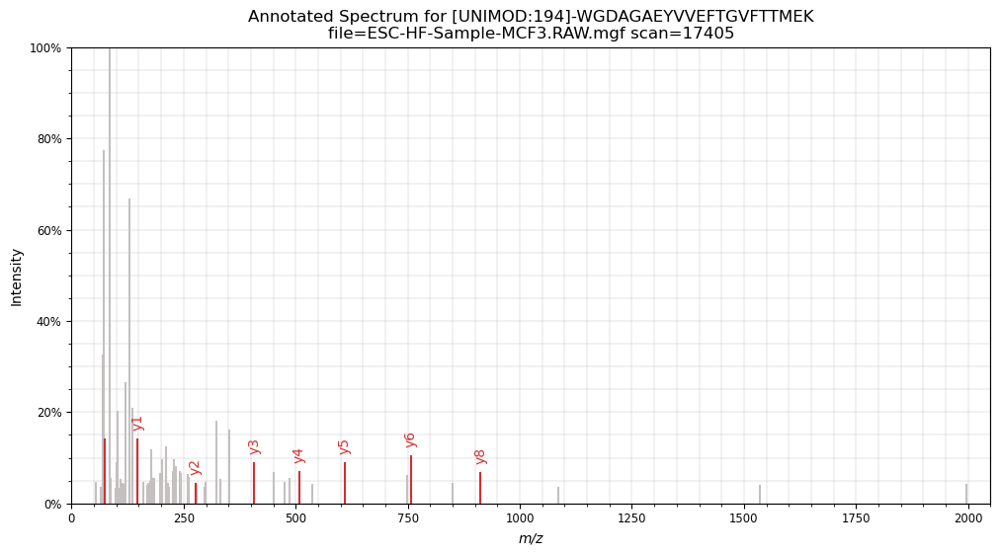

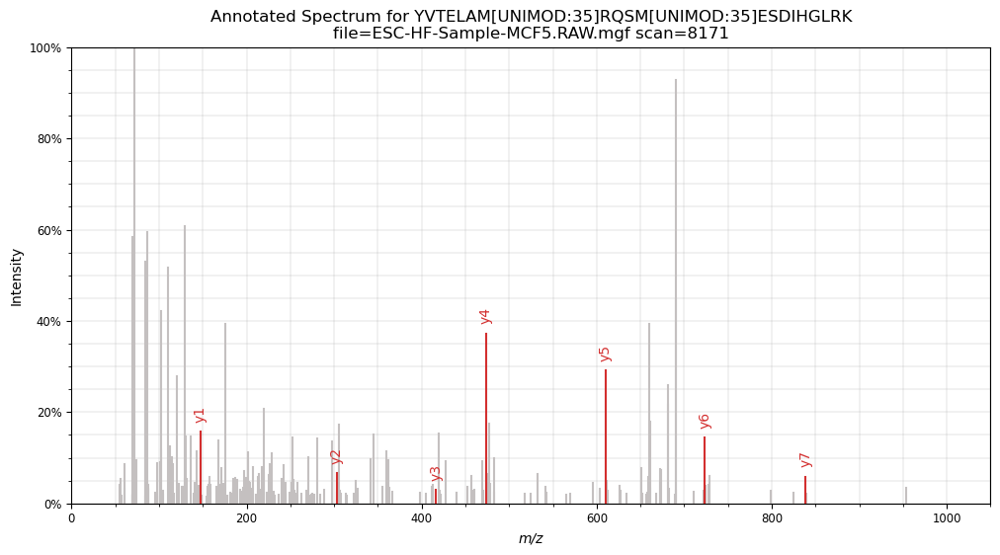

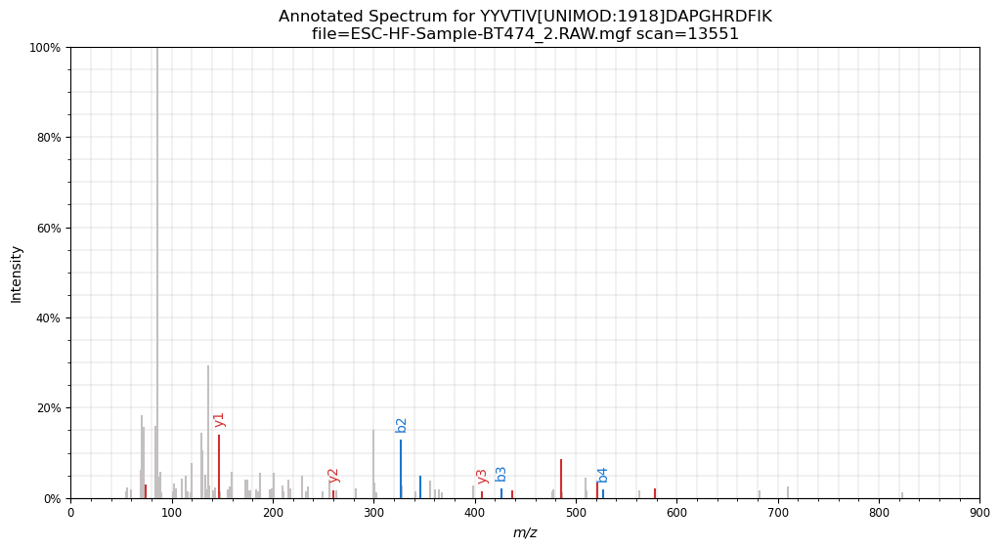

In [58]:
#PROBABLY I INCORRECTLY PASSED THE MODIFICATION PARSING TO PEPTIDE SEQUENCE
#- REVISE https://pyteomics.readthedocs.io/en/latest/api/parser.html#pyteomics.parser.to_proforma
pdf = matplotlib.backends.backend_pdf.PdfPages("nc_HPPpass_best_psms_v2.pdf")
nc_spectra_dict={}
for i,row in nc_toexplore.iterrows():
    #if i<181: continue
    target_title=f"scan={row['scan']}"
    target_file=row["spectrum_file_x"].split(".")[0]
    peptide_sequence=row["unimod_peptide"]
    set_charge=row["charge"]
    dataset=row["dataset"]
    mgf_file =row["spectrum_file_x"] 
    spectra = mgf.read(os.path.join(mgf_folder,dataset,mgf_file)) #read each time againe
    print(target_title, target_file, peptide_sequence,set_charge,dataset, i)
    # Parse the MGF file and find the matching spectrum
    for spectrum in spectra:
        if target_title in spectrum['params']['title']: 
            print(spectrum['params']['title'])
            mz_values = np.array(spectrum['m/z array'])
            intensities = np.array(spectrum['intensity array'])
            precursor_mz = float(spectrum['params'].get('pepmass', [0])[0])

            # Ensure charge is an integer
            charge = spectrum['params'].get('charge', [set_charge])
            if isinstance(charge, list):  # Some MGF files store charge as a list
                try:
                    charge = charge[charge.index(set_charge)]
                except ValueError:
                    charge = charge[0] #if no ionbot charge in list, then take first
            precursor_charge = int(charge)  # Convert to int explicitly

            retention_time = float(spectrum['params'].get('rtinseconds', float('nan')))
            
            nc_spectra_dict[spectrum['params']['title']]={
                "mgf":mgf_file,
                "identifier":target_title,
                "precursor_mz":precursor_mz,
                "precursor_charge":precursor_charge,  # Ensure it's an int
                "charge from ionbot":set_charge,
                "mz":mz_values,
                "intensity":intensities,
                "retention_time":retention_time
            }
            
            # Create an MsmsSpectrum object with the updated constructor
            spec = sus.MsmsSpectrum(
                identifier=target_title,
                precursor_mz=precursor_mz,
                precursor_charge=precursor_charge,  # Ensure it's an int
                mz=mz_values,
                intensity=intensities,
                retention_time=retention_time
            )

            # Preprocess the spectrum
            spec = spec.set_mz_range(min_mz=np.min(mz_values)-10, max_mz=np.max(mz_values)+10)  # Limit m/z range #how ?
            spec = spec.scale_intensity()  # Normalize intensity
            spec = spec.filter_intensity(0.01)  # Filter low-intensity peaks

            # Annotate the spectrum with the given peptide sequence
            spec.annotate_proforma(peptide_sequence, 20, "ppm")

            # Plot the annotated spectrum
            fig, ax = plt.subplots(figsize=(12, 6))
            sup.spectrum(spec, ax=ax)
            plt.title(f"Annotated Spectrum for {peptide_sequence}\nfile={mgf_file} {target_title}")
            #plt.show()
            pdf.savefig(fig)
            break  # Stop searching after finding the correct spectrum

            break  # Stop searching after finding the correct spectrum
    else:
        print("Spectrum not found.", target_title, target_file, dataset, charge, i)
pdf.close()

In [57]:
#pdf.close()

In [59]:
#with open('nc_spectra_mgf_dict.pickle', 'wb') as handle:
    pickle.dump(nc_spectra_dict, handle, protocol=pickle.HIGHEST_PROTOCOL)

In [78]:
nc_spectra_mgf_dict=pickle.load(open('nc_spectra_mgf_dict.pickle', 'rb'))

In [ ]:
#Mirrored way of visualisation, corrected modifications encodings

In [ ]:
#peprec
#peptide1 - ACDE 2
#peptide2 2|Carbamidomethyl ACDEFGHI 3
#peptide3 0|iTRAQ|10|Oxidation ACDEFGHIKMNPQ 2
#modification list
#Oxidation,15.994915,M

In [143]:
columns=["spec_id", "modifications", "peptide", "charge"]
nc_toexplore_peprec=pd.DataFrame(columns=columns)
nc_toexplore_mods=pd.DataFrame(columns=[0,1,2])
for i,row in nc_toexplore.iterrows():
    mods=row["modifications_x"]
    #print(mods)
    mods_peprec=[f"{m.split('|')[0]}|{m.split(']')[1].split('[')[0]}" if m!='Unmodified' else '-' for m in mods.split("||")]
    #print("|".join(set(mods)))
    nc_toexplore_peprec.loc[len(nc_toexplore_peprec)]=[row["scan"],"|".join(set(mods_peprec)),row["database_peptide_x"],row["charge"]]
    mods_mods=[f"{m.split(']')[1].split('[')[0]},*,{m.split(']')[1].split('[')[1].rstrip(']')}" for m in mods.split("||")  if m!='Unmodified']
    for m in mods_mods:
        nc_toexplore_mods.loc[len(nc_toexplore_mods)]=m.split(",")

In [ ]:
nc_toexplore_peprec.to_csv("nc_toexplore_peprec.csv",index=False)

In [146]:
nc_toexplore_mods.drop_duplicates(inplace=True)

In [191]:
#dounload unimod.xml on 09.02.2025 (v2) https://www.unimod.org/downloads.html
with open('unimod.xml') as topo_file:
    topo_lines = topo_file.readlines()
    for i,row in nc_toexplore_mods.iterrows():   
        #print(row[0])
        k=0; found=False
        for j,line in enumerate(topo_lines):            
            if f'title="{row[0]}"' in line:
                #print(line)
                
                while found==False:
                    #print(topo_lines[j+k])
                    if "<umod:delta" in topo_lines[j+k]:
                        found=True
                        #print(topo_lines[j+k])
                        mass_line=topo_lines[j+k]
                        mass_num=float(mass_line.lstrip('<umod:delta mono_mass="').split(" ")[0].rstrip('"'))
                        #print(mass_num)
                    k+=1
                nc_toexplore_mods.loc[i,1]=mass_num
                break
        if found==False:
            print("not found",i,row[0])
    
topo_file.close()

not found 3 Lys->AminoadipicAcid
not found 5 Hydroxylation
not found 30 Cation:Ni:II:
not found 31 Cation:Ni:II:
not found 43 Lys->CamCys
not found 100 Cation:Al:III:
not found 130 Glu->pyro-Glu+Methyl:2H(2)13C(1)
not found 133 Succinyl_2H(4)
not found 137 Met->Hse
not found 205 Carboxy->Thiocarboxy
not found 232 Glu->pyro-Glu+Methyl
not found 277 Pro->pyro-Glu
not found 351 Methyl_2H(3)+Acetyl_2H(3)
not found 373 Pro->Pyrrolidinone
not found 395 Cation:Fe:III:


In [196]:
#Cation:Ni[II], Cation:Al[III], Succinyl:2H(4), Methyl:2H(3)+Acetyl:2H(3)
#Cation:Fe[III]
fill_manualy=[14.96328,63.998285,55.919696,55.919696,
             31.935685,23.958063,-0.979006,104.041151,
             -29.992806,15.977156,-0.979006,13.979265,
             62.063875,-30.010565,52.911464]
nc_toexplore_mods.loc[nc_toexplore_mods[1]=="*",1]=fill_manualy

In [199]:
nc_toexplore_mods.to_csv("nc_toexplore_mods.csv",index=False)

In [211]:
#run MS2PIP on server 09-03-2025
ms2pip_spectra=pd.read_csv("ms2pip_predictions.csv")
ms2pip_spectra["ion"].replace("B","b",inplace=True)
ms2pip_spectra["ion"].replace("Y","y",inplace=True)

In [212]:
ms2pip_spectra.columns

Index(['spec_id', 'charge', 'ion', 'ionnumber', 'mz', 'prediction'], dtype='object')

In [216]:
#def ms2pip_custom_annotate(ms2pip_spec): 
#    annotations = {row["mz"]:f'{row["ion"]}{row["ionnumber"]}' for i,row in ms2pip_spec.iterrows()}    
#    return annotations

#ms2pip_annotations=ms2pip_custom_annotate(ms2pip_spectra[ms2pip_spectra.spec_id==scan])
#for mz, label in ms2pip_annotations.items():
#    spec.annotations.append((mz, label))

In [ ]:
#coreect modifications


In [318]:
def get_modpep(row,ms2pip_mods_df,mode="spectrum_utils"):
    """
    modes: usi 
            '[UNIMOD:1]-AAK[UNIMOD:381]ALDRHQAHLC[UNIMOD:4]VLASNC[UNIMOD:4]DEPMYVK'
            spectrum_utils
            '[+42.010565]-AAK[+14.96328]ALDRHQAHLC[+57.021464]VLASNC[+57.021464]DEPMYVK'
            custom
            
    """
    #print(row)
    peptide=list(row["database_peptide_x"])
    modifications=row["modifications_x"]
    #print(row.modifications)
    if modifications=="Unmodified": return row["database_peptide_x"]
    if mode=="spectrum_utils" or mode=="custom":
        unimod_id=[mods.split("_or_")[0].split(']')[1].split('[')[0] if "_or_" in mods 
                   else mods.split(']')[1].split('[')[0]  
                   for mods in modifications.split("||")]
    elif mode=="usi":
        unimod_id=[mods.split("_or_")[0].split("|")[1].split("]")[0][1:] if "_or_" in mods 
               else mods.split("|")[1].split("]")[0][1:]  
               for mods in modifications.split("||") ]
    positions=[int(mods.split("_or_")[0].split("|")[0]) if "_or_" in mods 
               else int(mods.split("|")[0])  
               for mods in modifications.split("||")]
    i=0
    for pos,unimod_id in sorted(zip(positions, unimod_id), key=lambda pair: pair[0]): #sort by position
        if mode=="spectrum_utils":
            mod_row=ms2pip_mods_df[ms2pip_mods_df[0]==unimod_id].iloc[0]
            #print(mod_row)
            sign="+" if float(mod_row[1])>=0 else ""
            t=f"[{sign}{mod_row[1]}]"
        elif mode=="usi":
            t=f"[UNIMOD:{unimod_id}]"
        elif mode=="custom":
            t=f"({unimod_id})"
        if pos==0: t=t+"-"
        peptide.insert(pos+i,t)
        i+=1 #to correct the position
        #print(t)
    pep="".join(peptide)
    pep=pep.replace("--","-")
    return pep

In [319]:
nc_toexplore["pyteomics_peptide"]=np.nan
nc_toexplore["custom_peptide"]=np.nan
for i,row in nc_toexplore.iterrows():
    nc_toexplore.loc[i,"pyteomics_peptide"]=get_modpep(row,nc_toexplore_mods,"spectrum_utils")
    nc_toexplore.loc[i,"custom_peptide"]=get_modpep(row,nc_toexplore_mods,"custom")

In [320]:
nc_toexplore[["unimod_peptide","pyteomics_peptide","custom_peptide"]].values[0]

array(['[UNIMOD:1]-AAK[UNIMOD:381]ALDRHQAHLC[UNIMOD:4]VLASNC[UNIMOD:4]DEPMYVK',
       '[+42.010565]-AAK[+14.96328]ALDRHQAHLC[+57.021464]VLASNC[+57.021464]DEPMYVK',
       '(Acetyl)-AAK(Lys->AminoadipicAcid)ALDRHQAHLC(Carbamidomethyl)VLASNC(Carbamidomethyl)DEPMYVK'],
      dtype=object)

130327_o2_01_hu_C1_2hr.12293.12293.4 File:"130327_o2_01_hu_C1_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=12293"
130327_o2_01_hu_C1_2hr.34011.34011.3 File:"130327_o2_01_hu_C1_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=34011"
130327_o2_06_hu_P3_2hr.21058.21058.2 File:"130327_o2_06_hu_P3_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=21058"
130327_o2_04_hu_P2_2hr.20421.20421.4 File:"130327_o2_04_hu_P2_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=20421"
130327_o2_04_hu_P2_2hr.22519.22519.3 File:"130327_o2_04_hu_P2_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=22519"
130327_o2_06_hu_P3_2hr.32014.32014.3 File:"130327_o2_06_hu_P3_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=32014"
130327_o2_01_hu_C1_2hr.13864.13864.2 File:"130327_o2_01_hu_C1_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=13864"
130327_o2_04_hu_P2_2hr.21122.21122.4 File:"130327_o2_04_hu_P2_2hr.raw", NativeID:"controll

C:\Users\vasv1101\AppData\Local\Temp\ipykernel_151244\4045904566.py:46: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=(12, 8))


130327_o2_05_hu_C3_2hr.19213.19213.3 File:"130327_o2_05_hu_C3_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=19213"
130327_o2_06_hu_P3_2hr.25521.25521.2 File:"130327_o2_06_hu_P3_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=25521"
130327_o2_01_hu_C1_2hr.22921.22921.2 File:"130327_o2_01_hu_C1_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=22921"
130327_o2_01_hu_C1_2hr.7412.7412.2 File:"130327_o2_01_hu_C1_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=7412"
130327_o2_06_hu_P3_2hr.11052.11052.3 File:"130327_o2_06_hu_P3_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=11052"
130327_o2_02_hu_P1_2hr.34841.34841.2 File:"130327_o2_02_hu_P1_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=34841"
130327_o2_05_hu_C3_2hr.13799.13799.3 File:"130327_o2_05_hu_C3_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=13799"
130327_o2_01_hu_C1_2hr.16009.16009.3 File:"130327_o2_01_hu_C1_2hr.raw", NativeID:"controllerT

controllerType=0 controllerNumber=1 scan=6215
controllerType=0 controllerNumber=1 scan=21876
controllerType=0 controllerNumber=1 scan=21276
controllerType=0 controllerNumber=1 scan=17234
controllerType=0 controllerNumber=1 scan=8077
controllerType=0 controllerNumber=1 scan=3789
controllerType=0 controllerNumber=1 scan=16188
controllerType=0 controllerNumber=1 scan=22232
controllerType=0 controllerNumber=1 scan=20030
controllerType=0 controllerNumber=1 scan=23498
controllerType=0 controllerNumber=1 scan=18576
controllerType=0 controllerNumber=1 scan=20438
controllerType=0 controllerNumber=1 scan=11689
controllerType=0 controllerNumber=1 scan=16024
controllerType=0 controllerNumber=1 scan=15318
controllerType=0 controllerNumber=1 scan=1884
controllerType=0 controllerNumber=1 scan=5729
controllerType=0 controllerNumber=1 scan=16666
controllerType=0 controllerNumber=1 scan=19602
controllerType=0 controllerNumber=1 scan=3972
controllerType=0 controllerNumber=1 scan=6662
controllerType=0 con

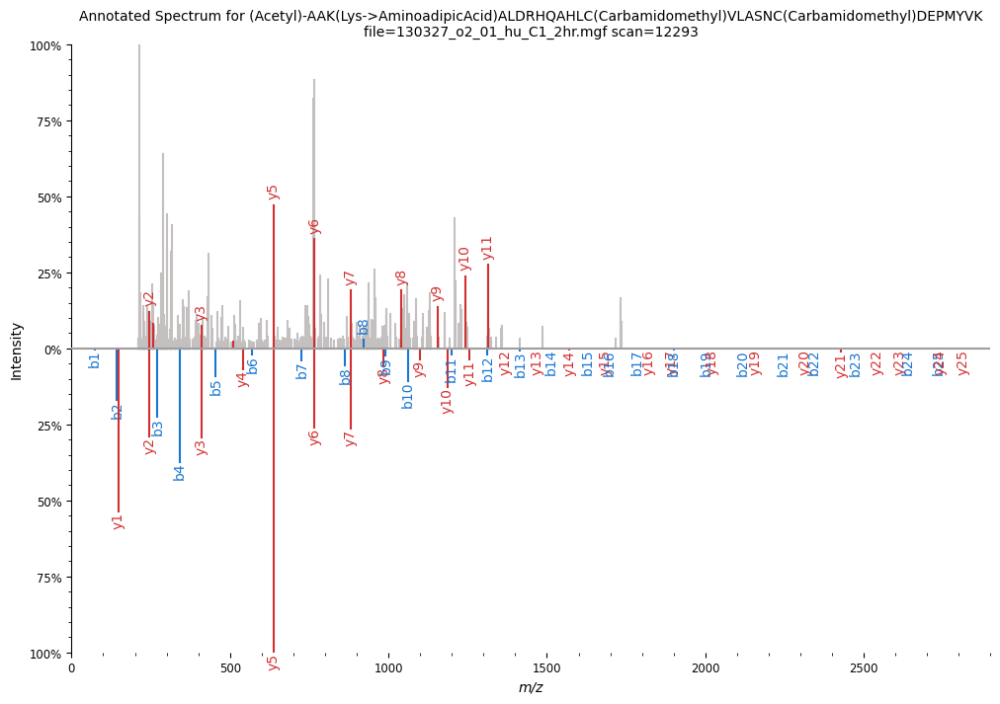

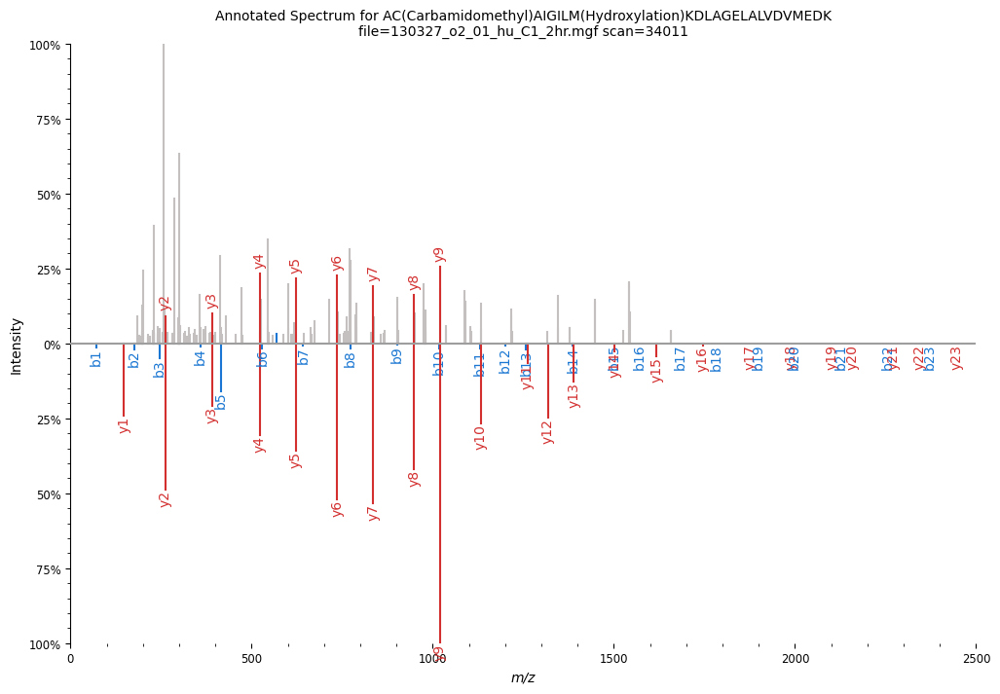

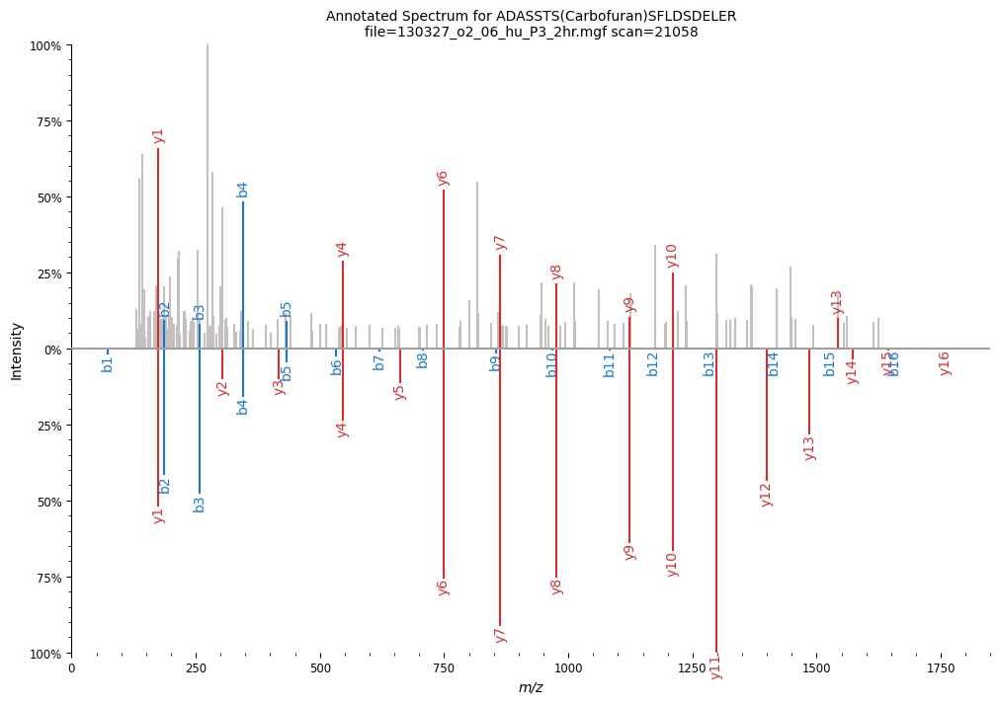

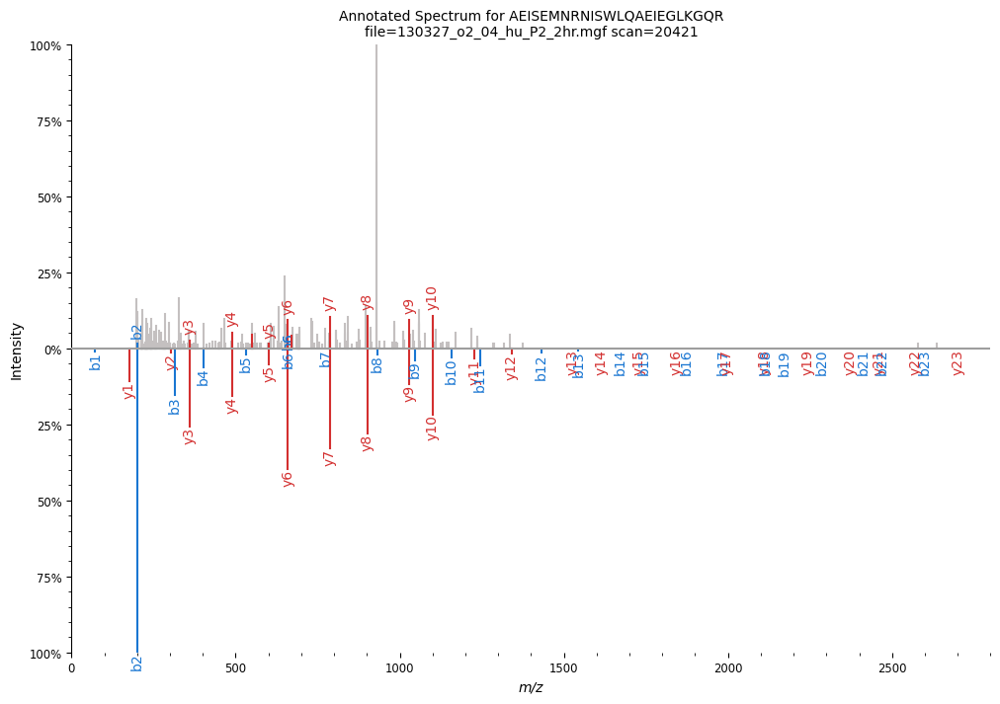

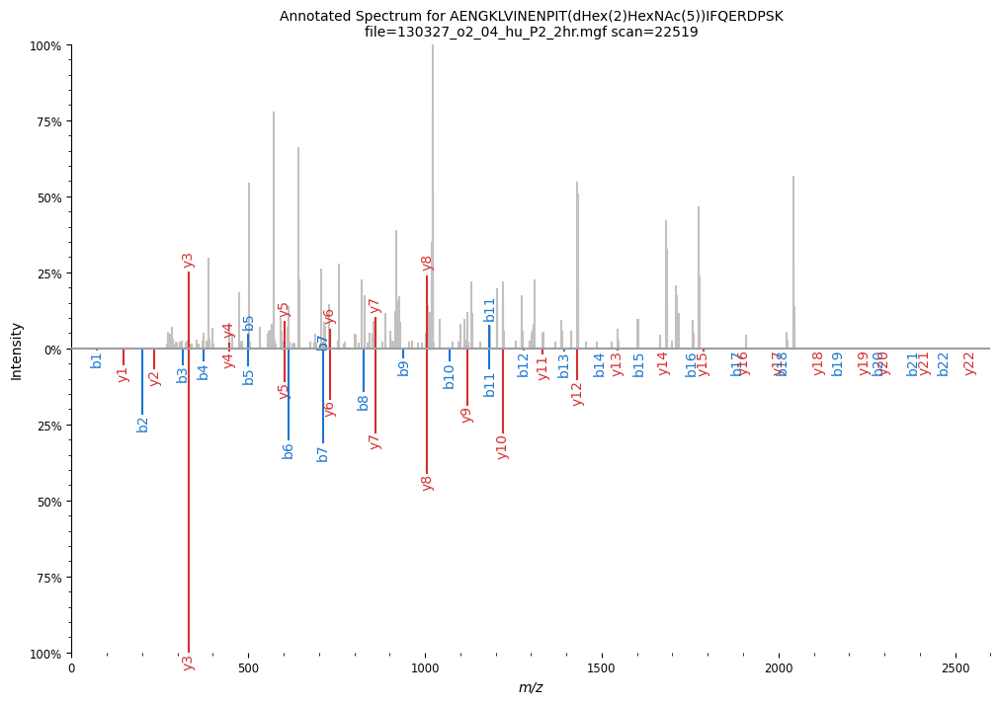

...

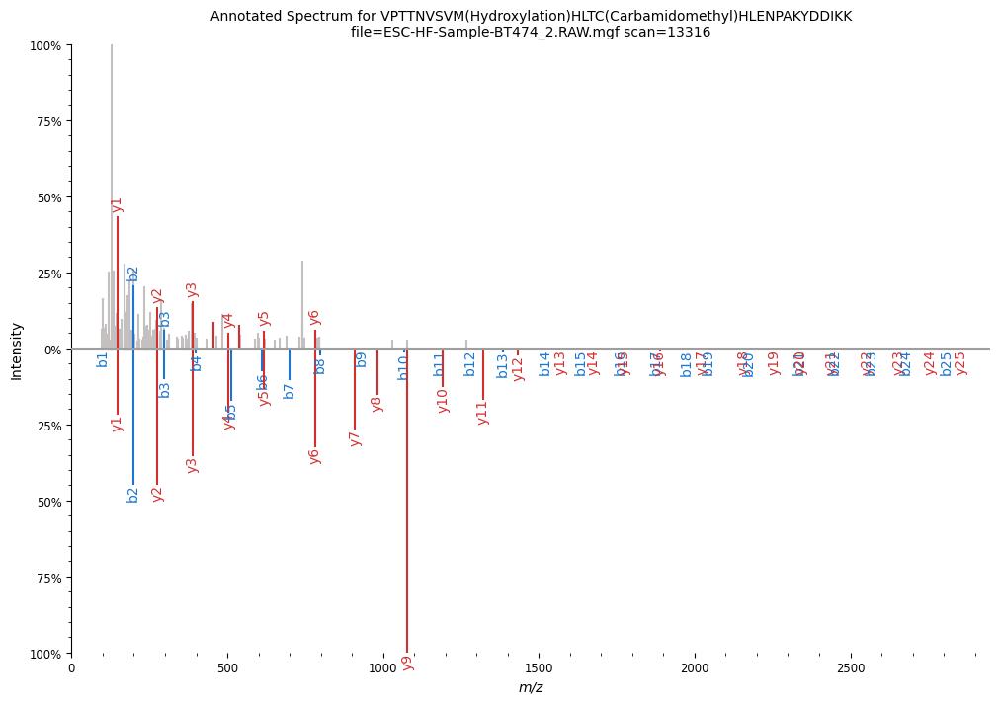

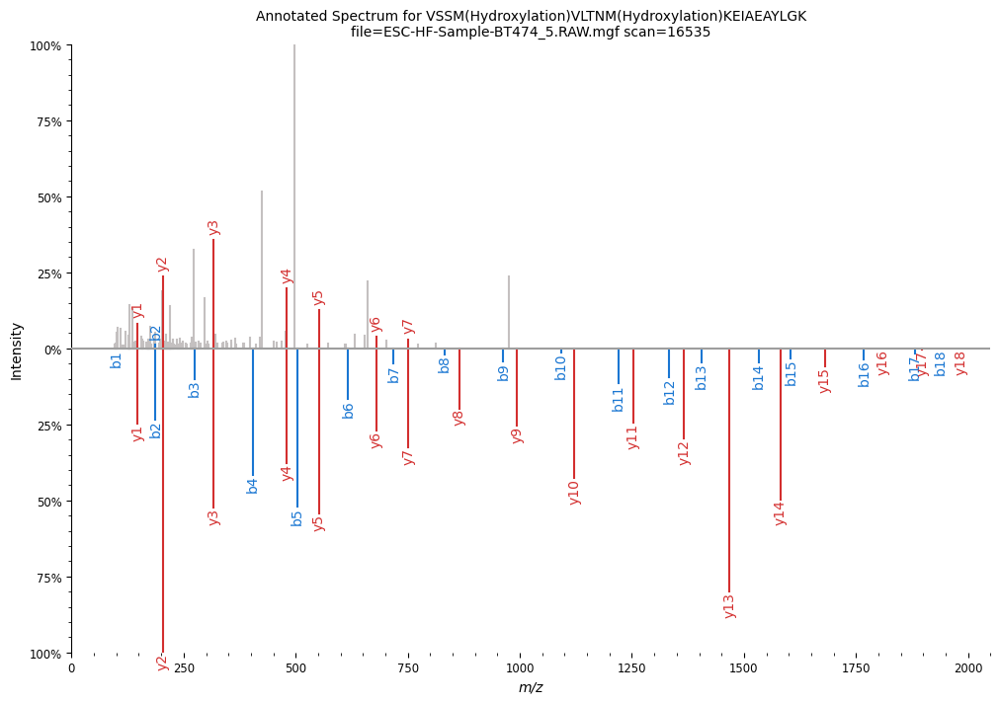

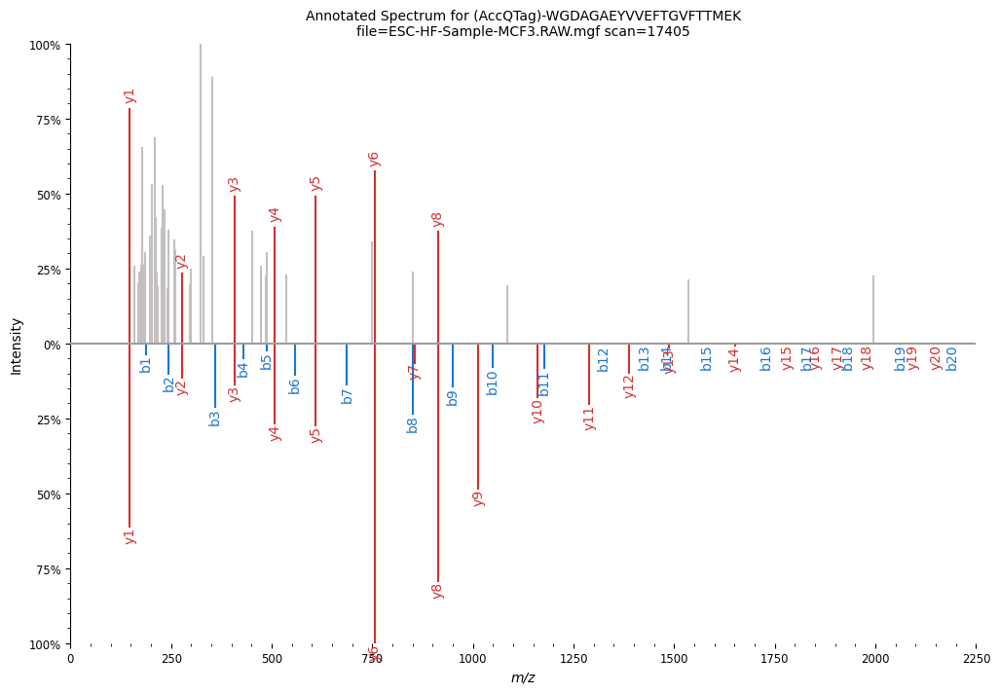

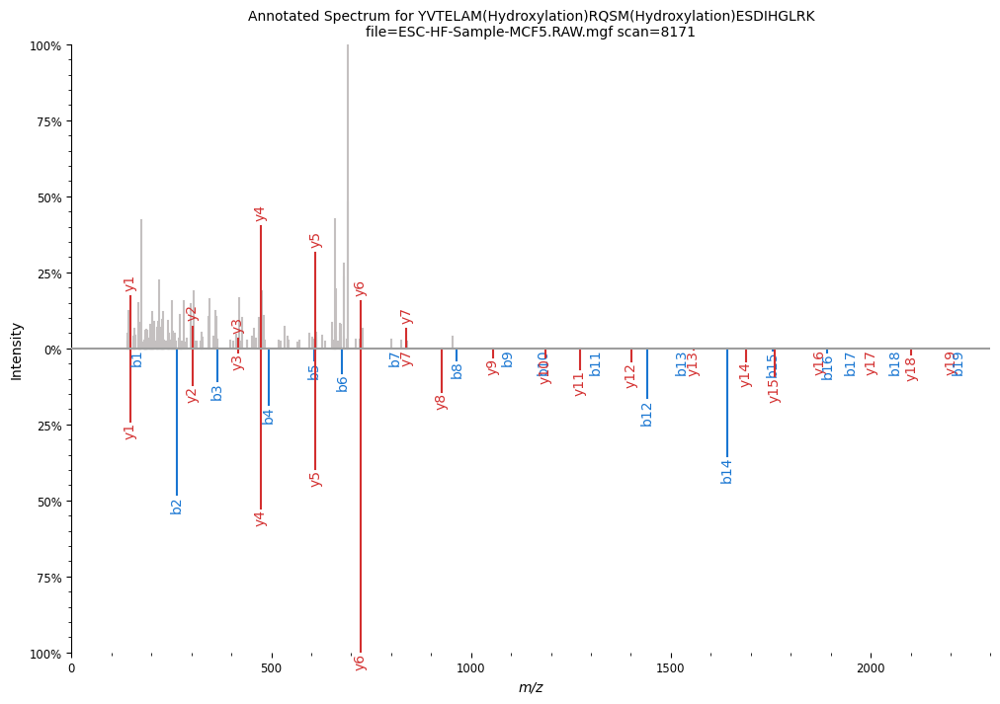

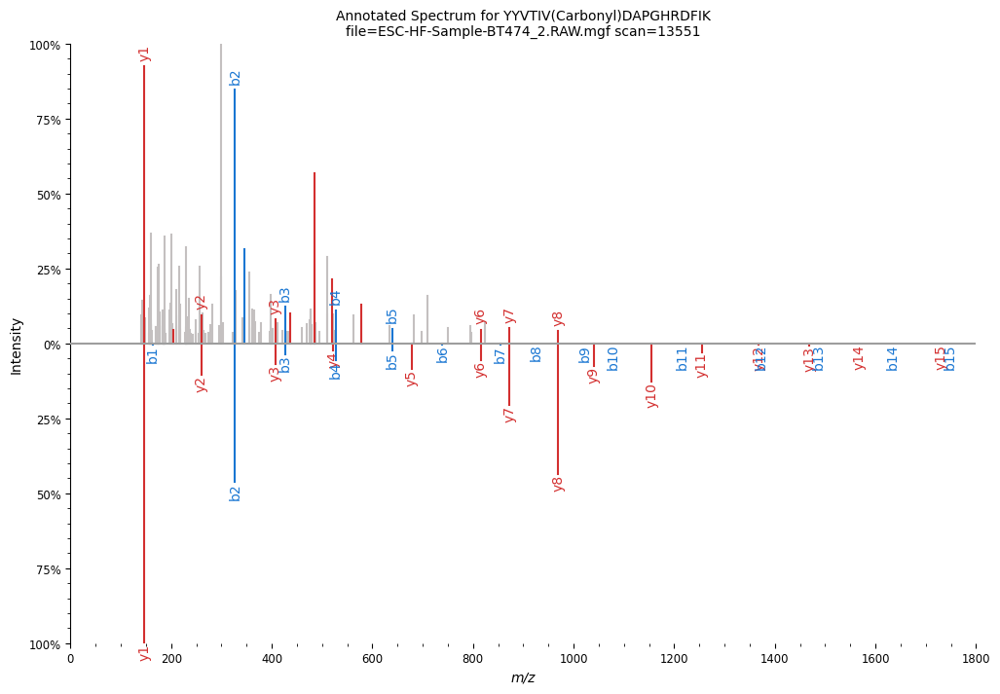

In [321]:
pdf = matplotlib.backends.backend_pdf.PdfPages("nc_HPPpass_best_psms_v3.pdf")
for key in nc_spectra_mgf_dict.keys():
    print(key)
    scan=int(nc_spectra_mgf_dict[key]["identifier"].lstrip("scan="))
    ms2pip_spec=ms2pip_spectra[ms2pip_spectra.spec_id==scan]
    plot_mz_min,plot_mz_max=ms2pip_spec.mz.min()-10, ms2pip_spec.mz.max()+10
    # Create the spectrum
    spec = sus.MsmsSpectrum(
        identifier=nc_spectra_mgf_dict[key]["identifier"],
        precursor_mz=nc_spectra_mgf_dict[key]["precursor_mz"],
        precursor_charge=nc_spectra_mgf_dict[key]["precursor_charge"], 
        mz=nc_spectra_mgf_dict[key]["mz"],
        intensity=nc_spectra_mgf_dict[key]["intensity"],
        retention_time=nc_spectra_mgf_dict[key]["retention_time"]
    )

    # Set mz range and filter
    spec = spec.set_mz_range(min_mz=plot_mz_min, max_mz=plot_mz_max)  
    spec = spec.scale_intensity() 
    #spec = spec.filter_intensity(0.01) 


    # Annotate with peptide sequence
    #peptide_sequence = nc_toexplore[nc_toexplore.scan == scan].database_peptide_x.iloc[0]
    peptide_sequence=nc_toexplore.loc[nc_toexplore.scan==scan,"pyteomics_peptide"].iloc[0]
    spec.annotate_proforma(peptide_sequence, 20, "ppm")

    # Create mirrored spectrum
    mirrored_spec = sus.MsmsSpectrum(
        identifier=spec.identifier,
        precursor_mz=spec.precursor_mz,
        precursor_charge=spec.precursor_charge,
        mz=ms2pip_spec.mz.to_numpy(),
        intensity=ms2pip_spec.prediction.to_numpy(),
        retention_time=spec.retention_time
    )

    mirrored_spec = mirrored_spec.set_mz_range(min_mz=plot_mz_min, max_mz=plot_mz_max)  
    mirrored_spec = mirrored_spec.scale_intensity() 
    #mirrored_spec = mirrored_spec.filter_intensity(0.01) 
    
    peptide_sequence_ms2pip=nc_toexplore.loc[nc_toexplore.scan==scan,"database_peptide_x"].iloc[0]
    mirrored_spec.annotate_proforma(peptide_sequence_ms2pip, 20, "ppm")

    # Plot original and mirrored spectra
    fig, ax = plt.subplots(figsize=(12, 8))

    # Plot mirrored (bottom)

    sup.mirror(spec, mirrored_spec, ax=ax,spectrum_kws={"grid":False})    
    #sup.facet(spec, spec, mirrored_spec, ax=ax,spectrum_kws={"grid":False})    
    
    
    # Titles and labels
    peptide_sequence_plot=nc_toexplore.loc[nc_toexplore.scan==scan,"custom_peptide"].iloc[0]
    ax.set_title(f"Annotated Spectrum for {peptide_sequence_plot}\nfile={nc_spectra_mgf_dict[key]['mgf']} scan={scan}",fontsize=10)
    ax.set_xlabel("m/z")
    ax.set_ylabel("Intensity")
    ax.spines['bottom'].set_visible(False)       
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
    
    #plt.show()
    pdf.savefig(fig)
pdf.close()

In [312]:
pdf.close()

In [296]:
from inspect import getmembers, isfunction
#no facet or mass_errors :(
print(getmembers(sup, isfunction))

[('_annotate_ion', <function _annotate_ion at 0x000001EFB6FE9080>), ('annotate_ion_type', <function annotate_ion_type at 0x000001EFBBA1A0C0>), ('mirror', <function mirror at 0x000001EFBD4DC540>), ('spectrum', <function spectrum at 0x000001EFBD4DC4A0>)]


controllerType=0 controllerNumber=1 scan=16188


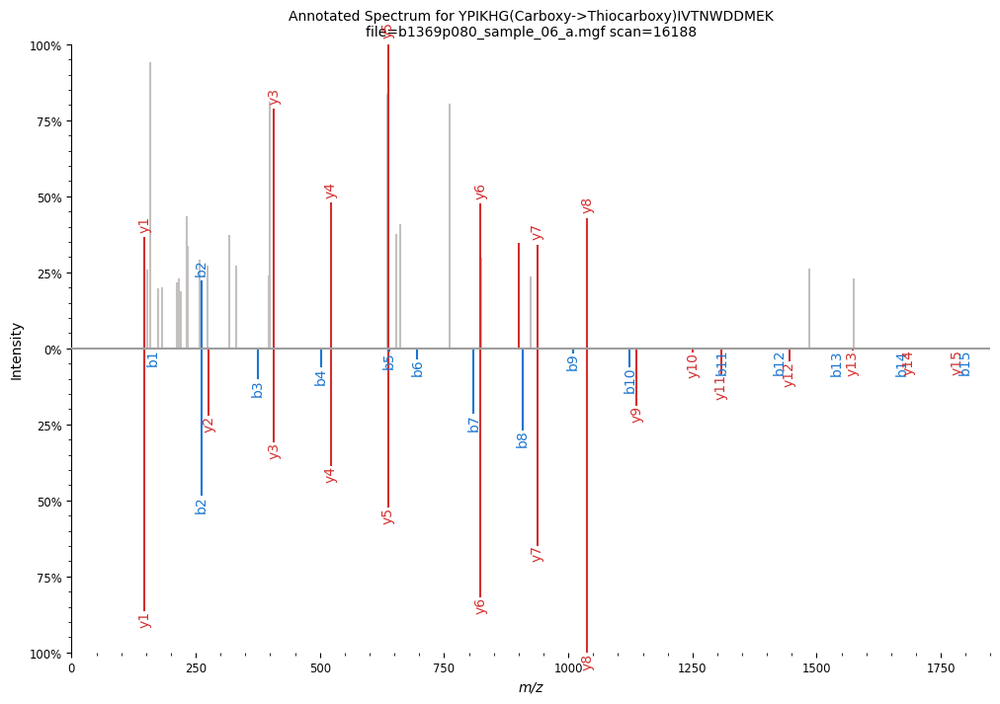

In [323]:
#save scan 16188 as svg
for key in nc_spectra_mgf_dict.keys():   
    scan=int(nc_spectra_mgf_dict[key]["identifier"].lstrip("scan="))
    if scan!=16188: continue
    print(key)
    ms2pip_spec=ms2pip_spectra[ms2pip_spectra.spec_id==scan]
    plot_mz_min,plot_mz_max=ms2pip_spec.mz.min()-10, ms2pip_spec.mz.max()+10
    # Create the spectrum
    spec = sus.MsmsSpectrum(
        identifier=nc_spectra_mgf_dict[key]["identifier"],
        precursor_mz=nc_spectra_mgf_dict[key]["precursor_mz"],
        precursor_charge=nc_spectra_mgf_dict[key]["precursor_charge"], 
        mz=nc_spectra_mgf_dict[key]["mz"],
        intensity=nc_spectra_mgf_dict[key]["intensity"],
        retention_time=nc_spectra_mgf_dict[key]["retention_time"]
    )

    spec = spec.set_mz_range(min_mz=plot_mz_min, max_mz=plot_mz_max)  
    spec = spec.scale_intensity() 

    peptide_sequence=nc_toexplore.loc[nc_toexplore.scan==scan,"pyteomics_peptide"].iloc[0]
    spec.annotate_proforma(peptide_sequence, 20, "ppm")

    mirrored_spec = sus.MsmsSpectrum(
        identifier=spec.identifier,
        precursor_mz=spec.precursor_mz,
        precursor_charge=spec.precursor_charge,
        mz=ms2pip_spec.mz.to_numpy(),
        intensity=ms2pip_spec.prediction.to_numpy(),
        retention_time=spec.retention_time
    )

    mirrored_spec = mirrored_spec.set_mz_range(min_mz=plot_mz_min, max_mz=plot_mz_max)  
    mirrored_spec = mirrored_spec.scale_intensity() 

    peptide_sequence_ms2pip=nc_toexplore.loc[nc_toexplore.scan==scan,"database_peptide_x"].iloc[0]
    mirrored_spec.annotate_proforma(peptide_sequence_ms2pip, 20, "ppm")

    fig, ax = plt.subplots(figsize=(12, 8))


    sup.mirror(spec, mirrored_spec, ax=ax,spectrum_kws={"grid":False})      
    
    
    # Titles and labels
    peptide_sequence_plot=nc_toexplore.loc[nc_toexplore.scan==scan,"custom_peptide"].iloc[0]
    ax.set_title(f"Annotated Spectrum for {peptide_sequence_plot}\nfile={nc_spectra_mgf_dict[key]['mgf']} scan={scan}",fontsize=10)
    ax.set_xlabel("m/z")
    ax.set_ylabel("Intensity")
    ax.spines['bottom'].set_visible(False)       
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
    plt.savefig(f"{nc_spectra_mgf_dict[key]['mgf']}_{scan}_spec.svg")

In [ ]:
#---------------not needed------------------

In [122]:
#WARNING: The script psm_utils.exe is installed in 'C:\Users\vasv1101\AppData\Roaming\Python\Python311\Scripts' which is not on PATH.
pip install ms2pip --user

  Obtaining dependency information for ms2pip from https://files.pythonhosted.org/packages/55/13/1c0bcc875c82bfb68ff63c676445f10f703d9e55cd93ceca3f2f7c91bd2a/ms2pip-4.1.0-cp311-cp311-win_amd64.whl.metadata
  Using cached ms2pip-4.1.0-cp311-cp311-win_amd64.whl.metadata (22 kB)
  Obtaining dependency information for xgboost<3,>=1.3 from https://files.pythonhosted.org/packages/43/80/0b5a2dfcf5b4da27b0b68d2833f05d77e1a374d43db951fca200a1f12a52/xgboost-2.1.4-py3-none-win_amd64.whl.metadata
  Using cached xgboost-2.1.4-py3-none-win_amd64.whl.metadata (2.1 kB)
  Obtaining dependency information for rich>=13 from https://files.pythonhosted.org/packages/19/71/39c7c0d87f8d4e6c020a393182060eaefeeae6c01dab6a84ec346f2567df/rich-13.9.4-py3-none-any.whl.metadata
  Using cached rich-13.9.4-py3-none-any.whl.metadata (18 kB)
  Obtaining dependency information for pydantic>=2 from https://files.pythonhosted.org/packages/f4/3c/8cc1cc84deffa6e25d2d0c688ebb80635dfdbf1dbea3e30c541c8cf4d860/pydantic-2.10.6-py

  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.
  Consider adding this directory to PATH or, if you prefer to suppress this warning, use --no-warn-script-location.
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
d3graph 2.5.0 requires markupsafe==2.0.1, but you have markupsafe 3.0.2 which is incompatible.
anaconda-cloud-auth 0.1.3 requires pydantic<2.0, but you have pydantic 2.10.6 which is incompatible.


In [124]:
!pip uninstall markupsafe && pip install markupsafe==2.0.1
!pip uninstall pydantic && pip install pydantic<2.0

^C
^C


In [125]:
pip uninstall markupsafe

^C
Note: you may need to restart the kernel to use updated packages.


In [ ]:
####

In [62]:
a=[v["identifier"] for k,v in nc_spectra_dict.items() if v["identifier"].startswith("scan")]
a1=[v["precursor_charge"] for k,v in nc_spectra_dict.items() if v["identifier"].startswith("scan")]
a2=[v["mgf"] for k,v in nc_spectra_dict.items() if v["identifier"].startswith("scan")]
a3=[v["charge from ionbot"] for k,v in nc_spectra_dict.items() if v["identifier"].startswith("scan")]

b=[k for k,v in nc_spectra_dict.items() if v["identifier"].startswith("scan")]

c=pd.DataFrame({"scan":a,"title":b,"mgf":a2,"charge":a1,"ionbot_charge":a3})
c[c.charge!=c.ionbot_charge]

,scan,title,mgf,charge,ionbot_charge


In [63]:
#table for scores
#some charge can be different from in ionbot annotation if mgf did not contain the same
#but here we have same charge as in ionbot
nc_toexplore_forscore=pd.DataFrame(columns=["dataset","spectrum_file","scan","sequence","charge"])
for i,row in nc_toexplore.iterrows():
    target_file=row["spectrum_file_x"]
    peptide_sequence=row["unimod_peptide"]
    set_charge=row["charge"]
    dataset=row["dataset"]
    nc_toexplore_forscore.loc[len(nc_toexplore_forscore)]=[dataset, target_file, row['scan'],peptide_sequence,set_charge]
nc_toexplore_forscore[["Marie score","Marie comment","Valeriia score","Valeriia comment"]]=np.nan

In [64]:
nc_toexplore_forscore.to_excel("nc_toexplore_forscore.xlsx",index=False)

In [36]:
nc_toexplore_forscore=pd.read_excel("nc_toexplore_forscore.xlsx")

In [65]:
#what about weird repeating modifications?
#they accure because ionbot contains sometimes several same peptidoforms of different (expected?) retention time
#try to delet them and see if it changes spectra visualisation
weird_modpep_scan=[28837,25461,23567,31024,19920,16159,22040,13350,8789,7753]
nc_toexplore_weird_modpep=nc_toexplore[nc_toexplore.scan.isin(weird_modpep_scan)]
nc_toexplore_weird_modpep.unimod_peptide=['DGS[UNIMOD:23]ASGT[UNIMOD:23]M[UNIMOD:35]LLEALDC[UNIMOD:4]ILPPTHPTDKPLR',
       '[UNIMOD:1]-M[UNIMOD:35]AIAT[UNIMOD:1765]GGAVFGEEGLT[UNIMOD:1654]LNLEDVQPHDLGK',
       'M[UNIMOD:35]C[UNIMOD:4]DIKEKLC[UNIMOD:4]YVALEFEQEM[UNIMOD:35]ASAASSSSLEK',
       '[UNIMOD:1]-MDMDMS[UNIMOD:40]PLR[UNIMOD:21]PQNYLFGC[UNIMOD:4]ELK',
       'FRC[UNIMOD:4]PEALFQ[UNIMOD:35]PSF[UNIMOD:35]LGMESC[UNIMOD:4]G[UNIMOD:35]I[UNIMOD:35]H[UNIMOD:35]D[UNIMOD:35]T[UNIMOD:35]T[UNIMOD:35]F[UNIMOD:35]NSIMK',
       'KLK[UNIMOD:1875]L[UNIMOD:34]E[UNIMOD:34]AE[UNIMOD:34]L[UNIMOD:34]GNM[UNIMOD:35]Q[UNIMOD:34]GLVEDFK',
       'LQLETEI[UNIMOD:34]E[UNIMOD:1918]A[UNIMOD:1918]VKEELLFM[UNIMOD:35]K',
       'LVEALC[UNIMOD:4]AE[UNIMOD:1827]HQIDLIKVDDNKK',
       'M[UNIMOD:35]NHEKYDNSLKIVSNASC[UNIMOD:4]TTNC[UNIMOD:4]LAPLAK',
       'TEEL[UNIMOD:1918]N[UNIMOD:34]R[UNIMOD:1918]E[UNIMOD:34]V[UNIMOD:1918]A[UNIMOD:1918]GHTDQLQM[UNIMOD:35]SR']
#checked - no difference

In [85]:
nc_toexplore.loc[nc_toexplore.scan.isin([4015,13243]),["unimod_peptide","charge"]]

,unimod_peptide,charge
83,KLLD[UNIMOD:1385]GEESRLESGMQNMSIHTK,3
103,TTHFVEGGD[UNIMOD:1915]ASNREDQINR,3


In [82]:
#look at spectra where some picks have no labels
[sd["mz"] for k,sd in nc_spectra_mgf_dict.items() if sd["identifier"] in ["scan=4015","scan=13243"]]

[array([ 120.0804138,  129.1021271,  136.0616302,  136.0752411,
         147.1119995,  152.0566711,  154.5608673,  175.118576 ,
         187.1081848,  197.1647034,  199.1803284,  201.1220245,
         201.5642242,  213.0864258,  217.0387878,  223.1547394,
         224.175293 ,  225.1594391,  227.0655518,  232.6582794,
         239.1136322,  243.1323853,  248.15979  ,  249.1588593,
         251.1500092,  252.1544647,  262.1509399,  276.168457 ,
         284.1238403,  301.1294556,  309.2634277,  312.0471497,
         337.2575073,  347.6404114,  355.2686462,  367.2084961,
         381.0930786,  385.2182312,  404.2252808,  404.7171631,
         414.2131653,  415.2165222,  442.2084961,  499.3005066,
         517.7514038,  526.7539063,  527.2991333,  528.295105 ,
         533.2711792,  585.3307495,  597.2155762,  602.3702393,
         604.328125 ,  636.9536133,  661.3621216,  662.3434448,
         715.3117065,  741.3255615,  751.6721191,  780.8900146,
         791.3585815,  797.3833618,  801

scan=28837 130327_o2_05_hu_C3_2hr DGS[UNIMOD:23]ASGT[UNIMOD:23]M[UNIMOD:35]LLEALDC[UNIMOD:4]ILPPTHPTDKPLR 3 PXD002057 11
130327_o2_05_hu_C3_2hr.28837.28837.3 File:"130327_o2_05_hu_C3_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=28837"


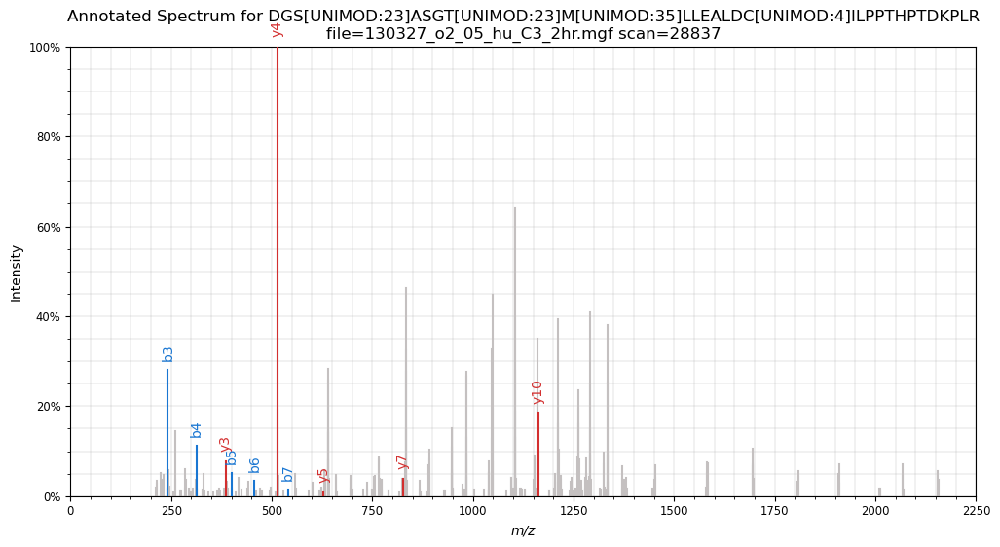

scan=25461 130327_o2_06_hu_P3_2hr [UNIMOD:1]-M[UNIMOD:35]AIAT[UNIMOD:1765]GGAVFGEEGLT[UNIMOD:1654]LNLEDVQPHDLGK 4 PXD002057 41
130327_o2_06_hu_P3_2hr.25461.25461.4 File:"130327_o2_06_hu_P3_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=25461"


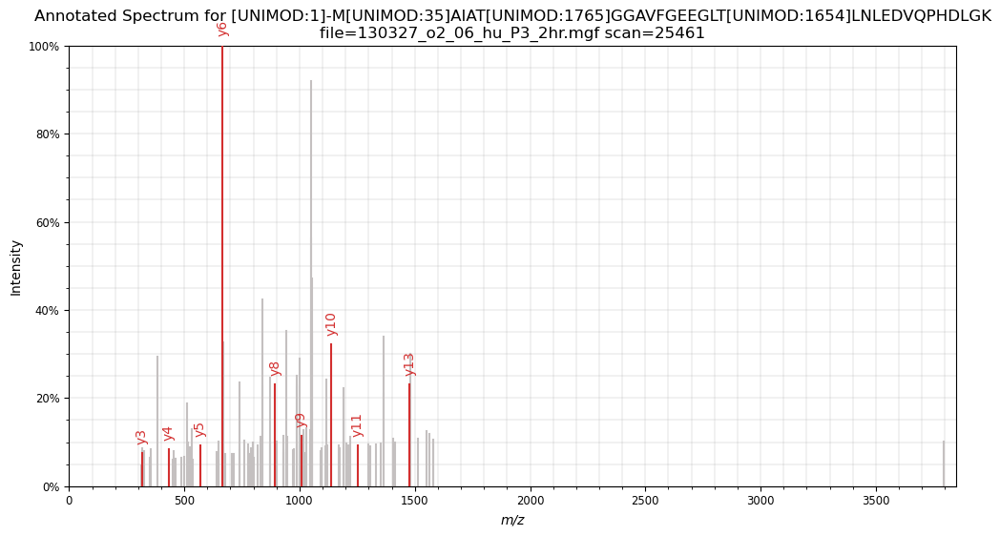

scan=23567 130327_o2_01_hu_C1_2hr M[UNIMOD:35]C[UNIMOD:4]DIKEKLC[UNIMOD:4]YVALEFEQEM[UNIMOD:35]ASAASSSSLEK 3 PXD002057 43
130327_o2_01_hu_C1_2hr.23567.23567.3 File:"130327_o2_01_hu_C1_2hr.raw", NativeID:"controllerType=0 controllerNumber=1 scan=23567"


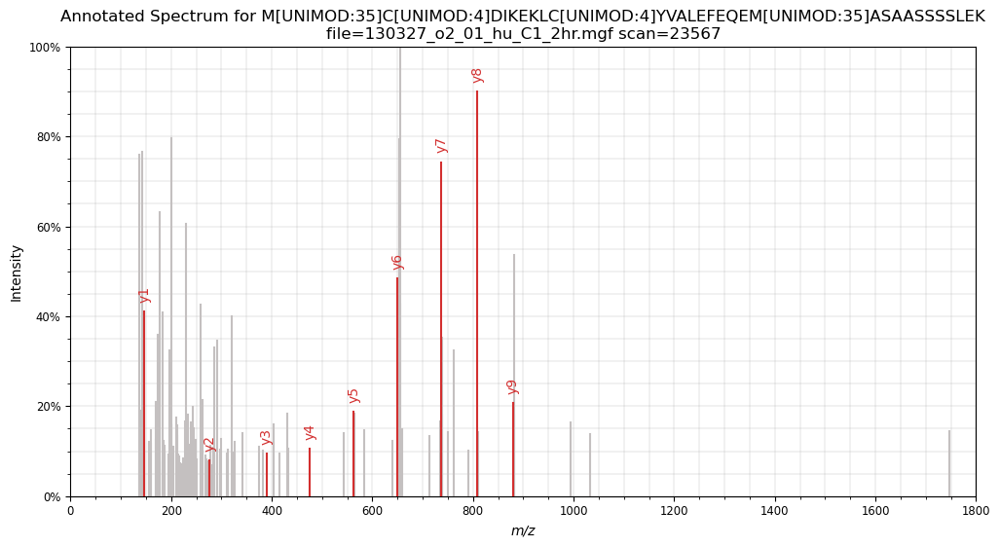

scan=31024 b1369p080_sample_05_a [UNIMOD:1]-MDMDMS[UNIMOD:40]PLR[UNIMOD:21]PQNYLFGC[UNIMOD:4]ELK 3 PXD003594 90
controllerType=0 controllerNumber=1 scan=31024


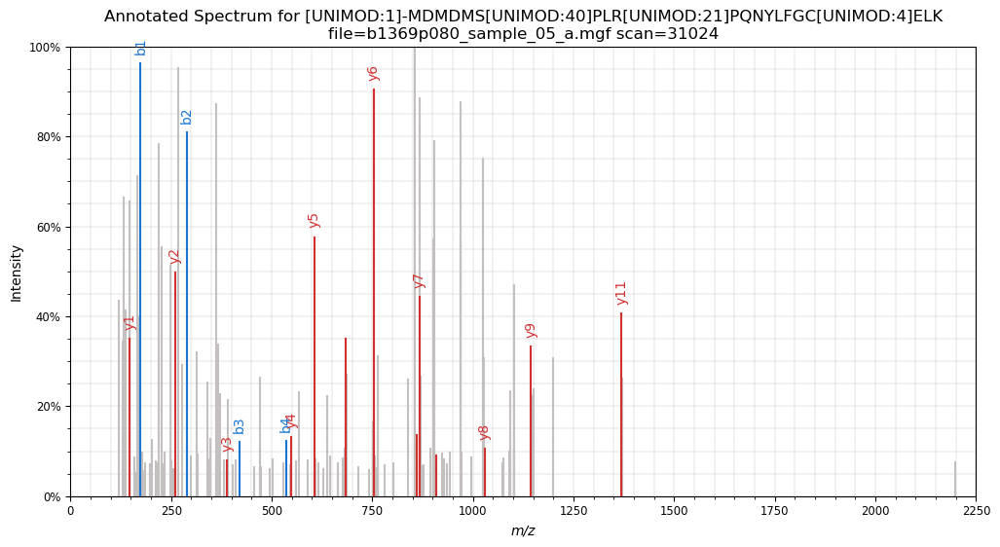

scan=19920 ESC-HF-Sample-MCF5 FRC[UNIMOD:4]PEALFQ[UNIMOD:35]PSF[UNIMOD:35]LGMESC[UNIMOD:4]G[UNIMOD:35]I[UNIMOD:35]H[UNIMOD:35]D[UNIMOD:35]T[UNIMOD:35]T[UNIMOD:35]F[UNIMOD:35]NSIMK 4 PXD014258 129
controllerType=0 controllerNumber=1 scan=19920


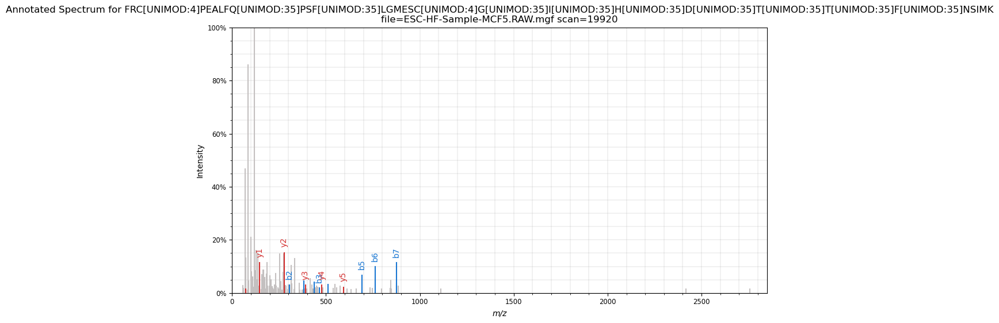

scan=16159 ESC-HF-Sample-MCF2 KLK[UNIMOD:1875]L[UNIMOD:34]E[UNIMOD:34]AE[UNIMOD:34]L[UNIMOD:34]GNM[UNIMOD:35]Q[UNIMOD:34]GLVEDFK 3 PXD014258 148
controllerType=0 controllerNumber=1 scan=16159


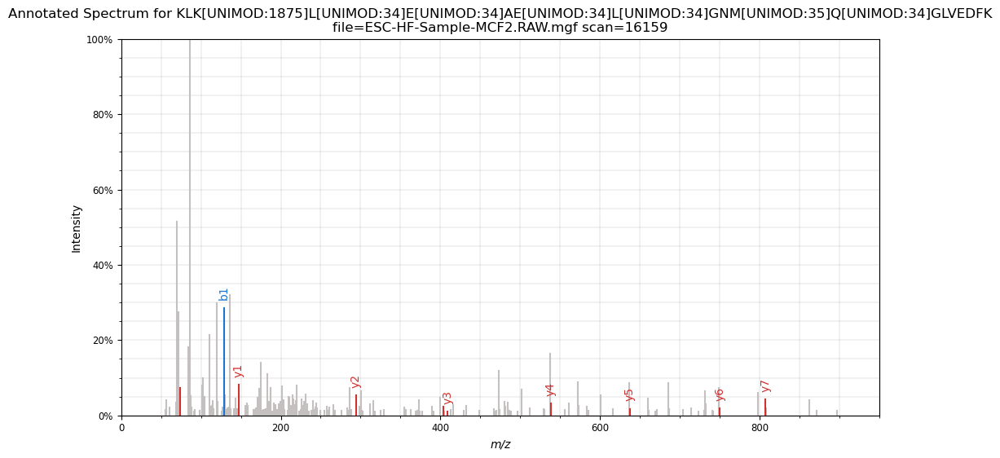

scan=22040 ESC-HF-Sample-MCF5 LQLETEI[UNIMOD:34]E[UNIMOD:1918]A[UNIMOD:1918]VKEELLFM[UNIMOD:35]K 3 PXD014258 166
controllerType=0 controllerNumber=1 scan=22040


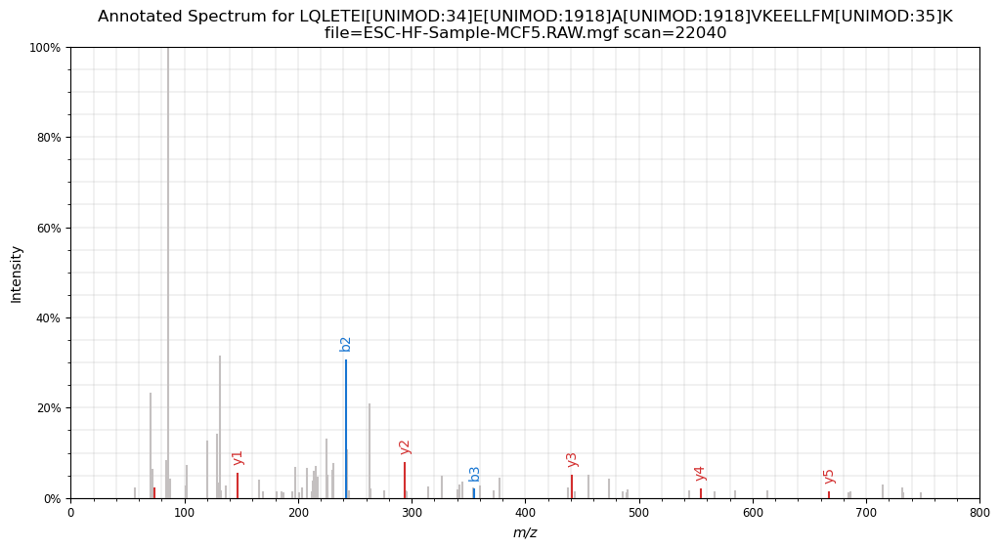

scan=13350 ESC-HF-Sample-MCF4 LVEALC[UNIMOD:4]AE[UNIMOD:1827]HQIDLIKVDDNKK 4 PXD014258 170
controllerType=0 controllerNumber=1 scan=13350


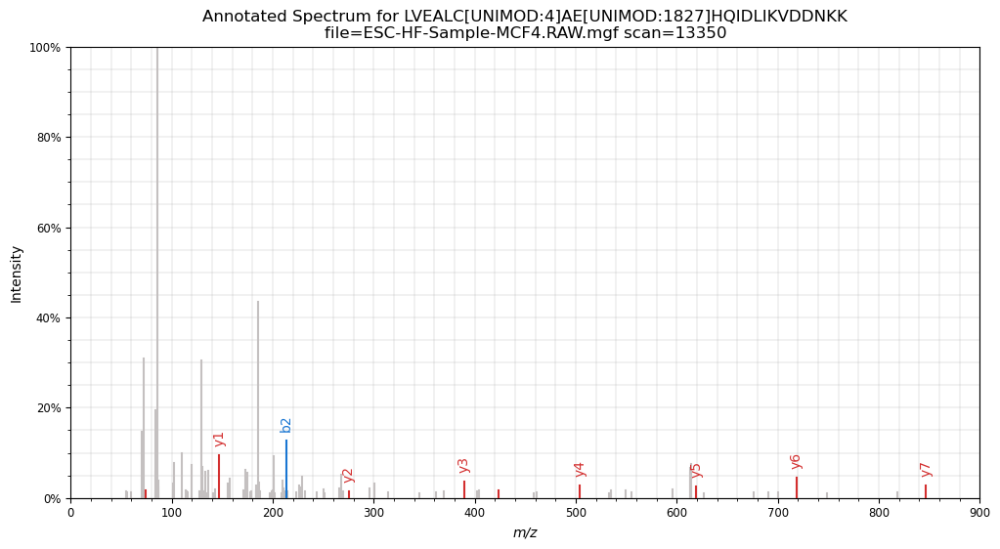

KeyboardInterrupt: 

In [75]:
for i,row in nc_toexplore_weird_modpep.iterrows():
    target_title=f"scan={row['scan']}"
    target_file=row["spectrum_file_x"].split(".")[0]
    peptide_sequence=row["unimod_peptide"]
    set_charge=row["charge"]
    dataset=row["dataset"]
    mgf_file =row["spectrum_file_x"] 
    spectra = mgf.read(os.path.join(mgf_folder,dataset,mgf_file)) #read each time againe
    print(target_title, target_file, peptide_sequence,set_charge,dataset, i)
    # Parse the MGF file and find the matching spectrum
    for spectrum in spectra:
        if target_title in spectrum['params']['title']: 
            print(spectrum['params']['title'])
            mz_values = np.array(spectrum['m/z array'])
            intensities = np.array(spectrum['intensity array'])
            precursor_mz = float(spectrum['params'].get('pepmass', [0])[0])

            # Ensure charge is an integer
            charge = spectrum['params'].get('charge', [set_charge])
            if isinstance(charge, list):  # Some MGF files store charge as a list
                try:
                    charge = charge[charge.index(set_charge)]
                except ValueError:
                    charge = charge[0] #if no ionbot charge in list, then take first
            precursor_charge = int(charge)  # Convert to int explicitly

            retention_time = float(spectrum['params'].get('rtinseconds', float('nan')))
            
            nc_spectra_dict[spectrum['params']['title']]={
                "mgf":mgf_file,
                "identifier":target_title,
                "precursor_mz":precursor_mz,
                "precursor_charge":precursor_charge,  # Ensure it's an int
                "charge from ionbot":set_charge,
                "mz":mz_values,
                "intensity":intensities,
                "retention_time":retention_time
            }
            
            # Create an MsmsSpectrum object with the updated constructor
            spec = sus.MsmsSpectrum(
                identifier=target_title,
                precursor_mz=precursor_mz,
                precursor_charge=precursor_charge,  # Ensure it's an int
                mz=mz_values,
                intensity=intensities,
                retention_time=retention_time
            )

            # Preprocess the spectrum
            spec = spec.set_mz_range(min_mz=np.min(mz_values)-10, max_mz=np.max(mz_values)+10)  # Limit m/z range #how ?
            spec = spec.scale_intensity()  # Normalize intensity
            spec = spec.filter_intensity(0.01)  # Filter low-intensity peaks

            # Annotate the spectrum with the given peptide sequence
            spec.annotate_proforma(peptide_sequence, 20, "ppm")

            # Plot the annotated spectrum
            fig, ax = plt.subplots(figsize=(12, 6))
            sup.spectrum(spec, ax=ax)
            plt.title(f"Annotated Spectrum for {peptide_sequence}\nfile={mgf_file} {target_title}")
            plt.show()
            break  # Stop searching after finding the correct spectrum

            break  # Stop searching after finding the correct spectrum
    else:
        print("Spectrum not found.", target_title, target_file, dataset, charge, i)